# Loading Prerequisites

In [1]:
import numpy as np
import cv2
import glob
import pickle
import imageio
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from collections import deque
#!pip install imageio-ffmpeg
#moviepy=1.0.0
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# Camera Calibration

In [2]:
def camera_calibration(input_folder, output_folder, save = False):
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp =  np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    inp_images = glob.glob(f'{input_folder}/calibration*.jpg')

    for idx, fname in enumerate(inp_images):
        img = cv2.imread(fname) 
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img_size = (gray.shape[1], gray.shape[0])
        ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
            img_copy = np.copy(img)
            cv2.drawChessboardCorners(img_copy, (9,6), corners, ret)
            
            # writing to output folder
            cv2.imwrite(f'{output_folder}/calibration_output_{idx+1}.jpg', img_copy)
            displayImage(img, img_copy, "Corners Found")
    
    
    ret, mtx, dist , rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    calibration_data = {'ret': ret,
                           'mtx' : mtx,
                           'dist': dist,
                           'rvecs': rvecs,
                           'tvecs': tvecs,
                           'obj_points' : objpoints,
                           'img_points': imgpoints}
    if save:
        pickle.dump( calibration_data, open( "pickle/calibration_data.p", "wb" ) )
    return calibration_data

In [3]:
def displayImage(img, output, title):
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #output = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(output)
    ax2.set_title(title, fontsize=30)

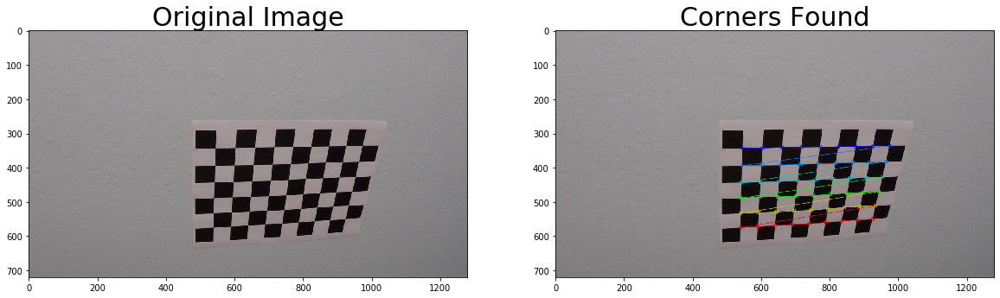

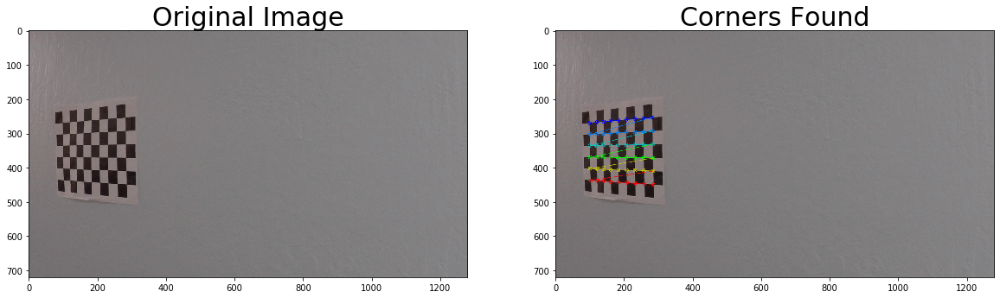

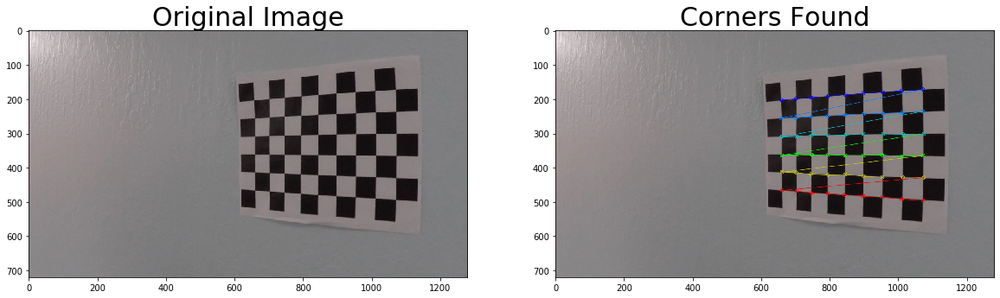

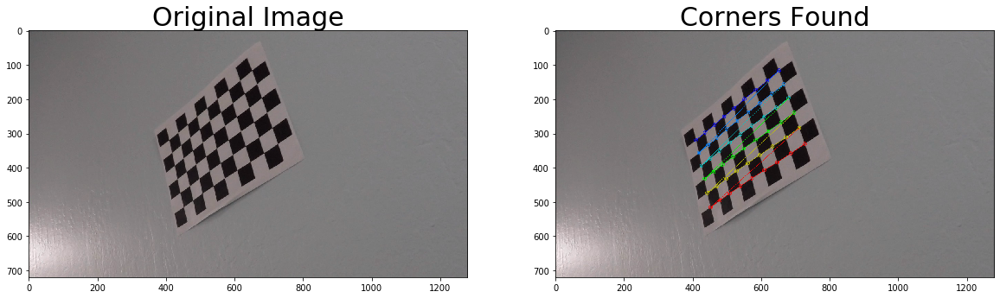

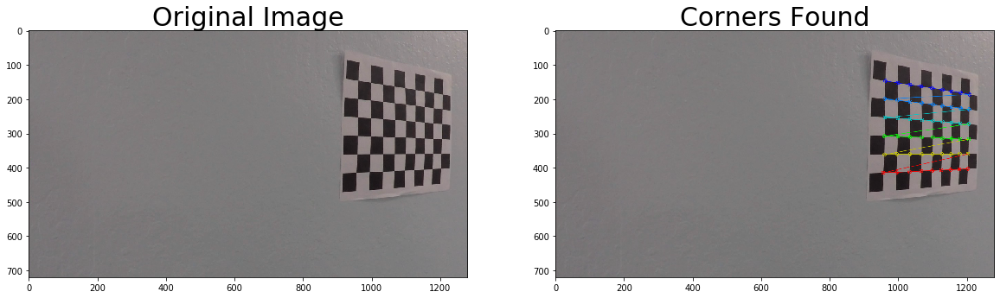

...

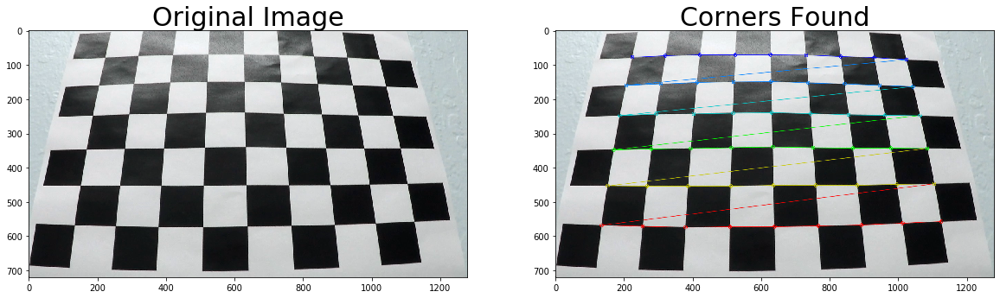

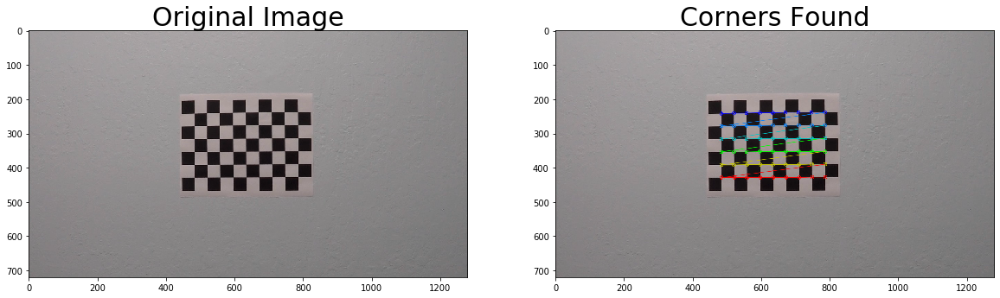

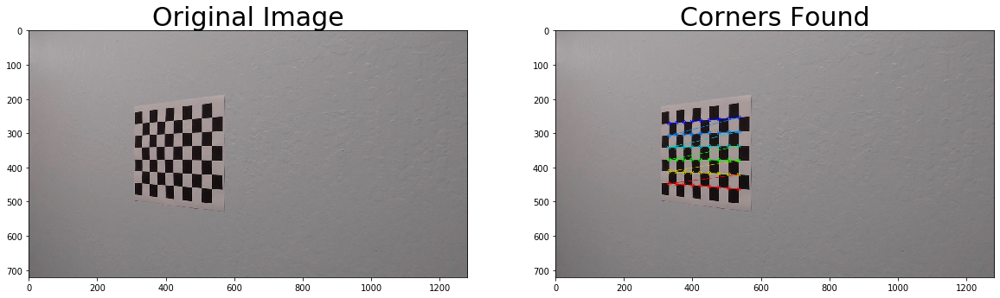

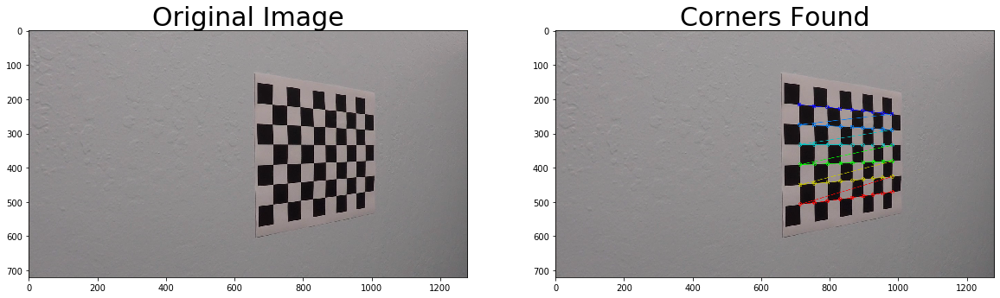

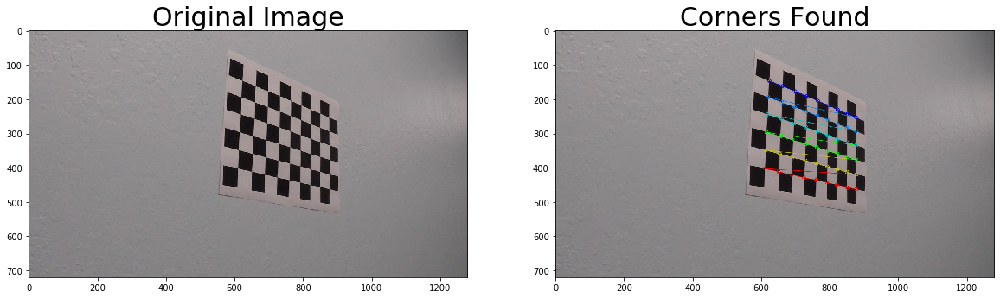

In [4]:
INPUT_FOLDER = 'camera_cal'
OUTPUT_FOLDER = 'output_images/ChessBoardCorner_Images'

calib_data = camera_calibration(INPUT_FOLDER, OUTPUT_FOLDER, save = True)

# Distortion Correction

In [5]:
def distortion_correction(image, calib_data, display = True ):
    
    #displaying distortion correction
    
    mtx = calib_data['mtx']
    dist = calib_data['dist']
    objpoints = calib_data['obj_points']
    imgpoints = calib_data['img_points']
    if len(objpoints) == len(imgpoints):
        dst  = cv2.undistort(image, mtx, dist, None, mtx)
        
        if display:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
            displayImage(img = image, output = dst, title = 'Undistorted Image')
        return dst
    else:
        print('Sufficient Corners not found!')
        return None


In [6]:
INPUT_FOLDER = 'camera_cal'
OUTPUT_FOLDER = 'output_images/ChessBoardCorner_Images'
TEST_IMAGES = 'test_images'
CALIB_PICKLE = 'pickle/calibration_data.p'
test_image_paths = glob.glob(f'{TEST_IMAGES}/*.jpg')
calib_data = pickle.load(open(CALIB_PICKLE, 'rb'))

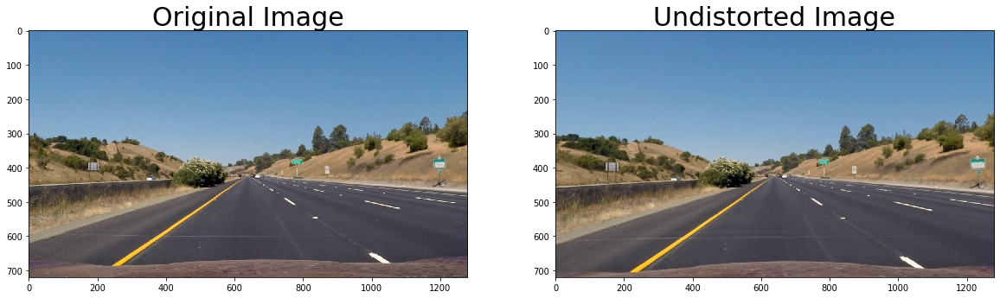

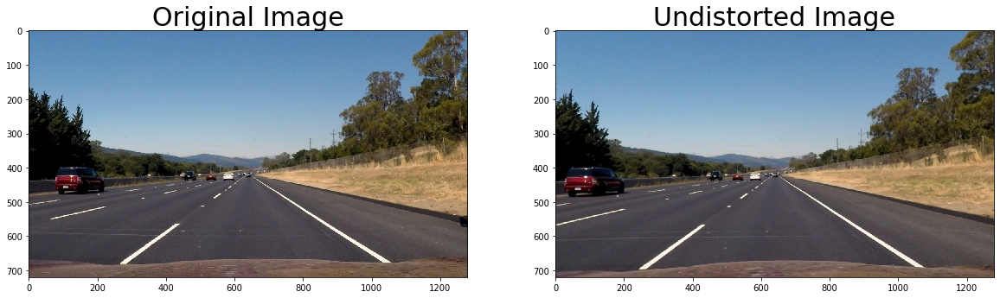

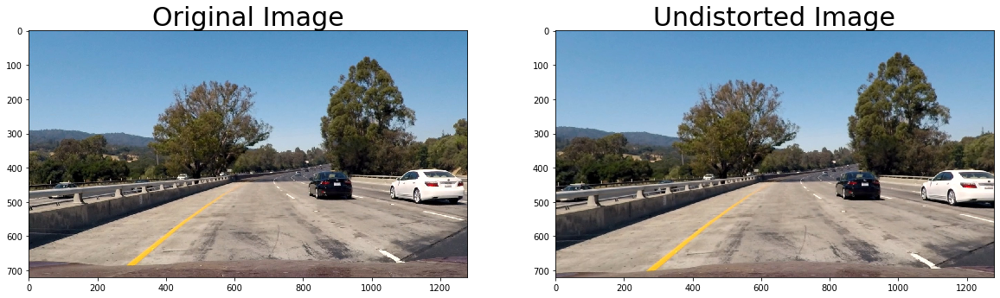

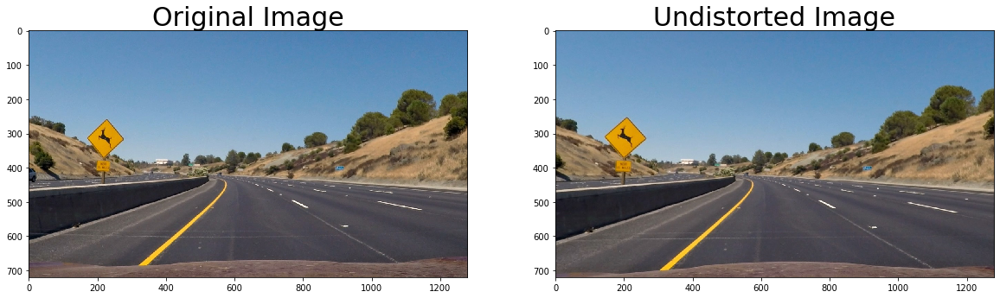

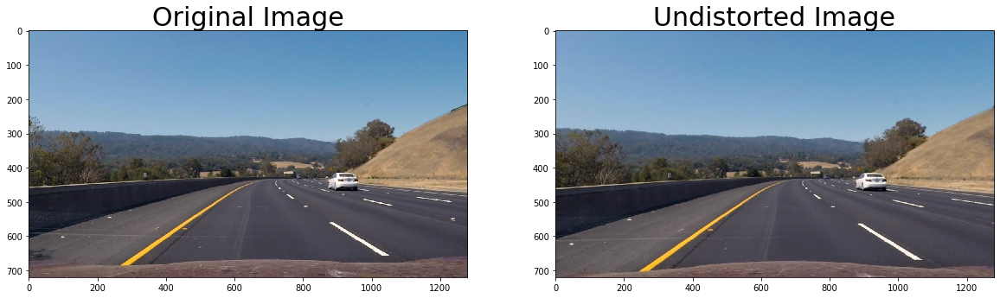

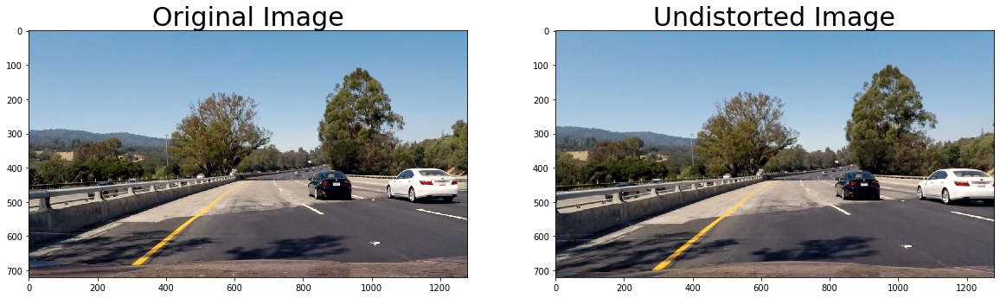

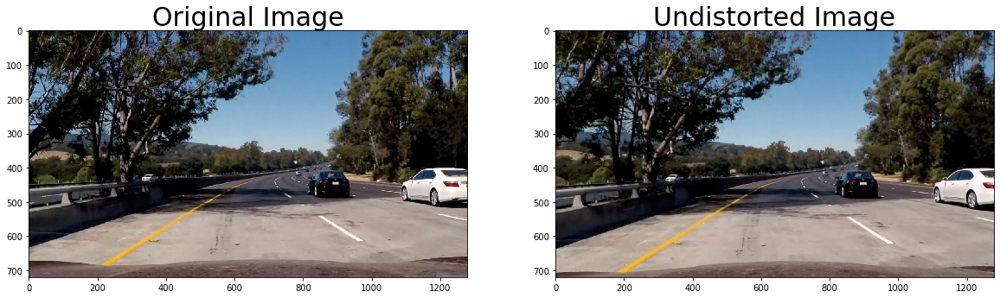

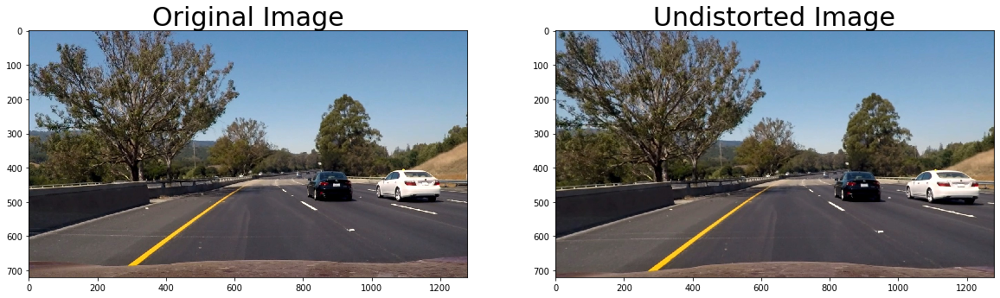

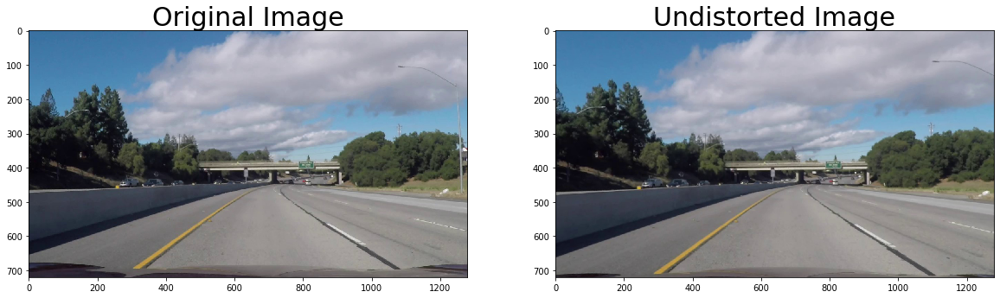

In [7]:
for idx , fname in enumerate(test_image_paths):
    image = cv2.imread(fname)
    dst = distortion_correction(image, calib_data)

# Histogram Equalization

In [8]:
def histogram_equalization(image, display = False):
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    lab_planes = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0,tileGridSize=(8,8))
    lab_planes[0] = clahe.apply(lab_planes[0])
    lab = cv2.merge(lab_planes)
    new_image = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
    
    if display:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(new_image, cmap='gray')
        ax2.set_title('New Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    else:
        return new_image

# Perspective Transformation

In [9]:
def perspectiveTransform(img, display = False):
    
    src = np.float32([[575,464],[707,464],
                          [190,720],[1100,720]])

    dst = np.float32([[450,0], [830,0], 
                        [450,720], [830,720]])
    
    
    pts = np.array([src[0],src[2], src[3], src[1], src[0]], np.int32)

    copy = img.copy()
    
    cv2.polylines(copy,[pts],True,(255,0,0), thickness=3)


    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]), flags = cv2.INTER_LINEAR)
    
    if display:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        
        ax1.imshow(copy)
        ax1.set_title('Undistorted Image', fontsize=30)
        ax2.imshow(warped)
        ax2.set_title('Warped Image', fontsize=30)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    return warped, Minv

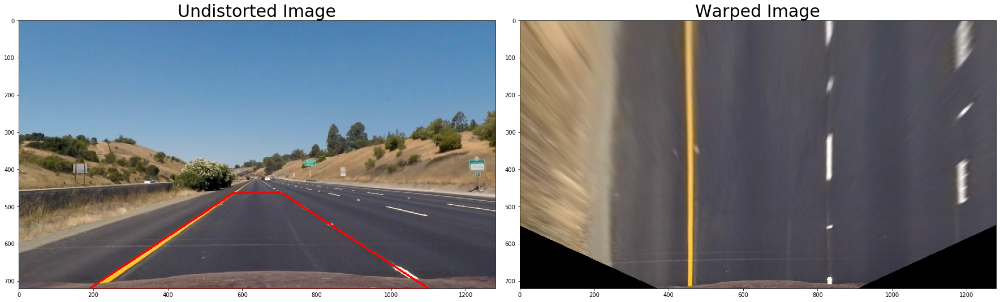

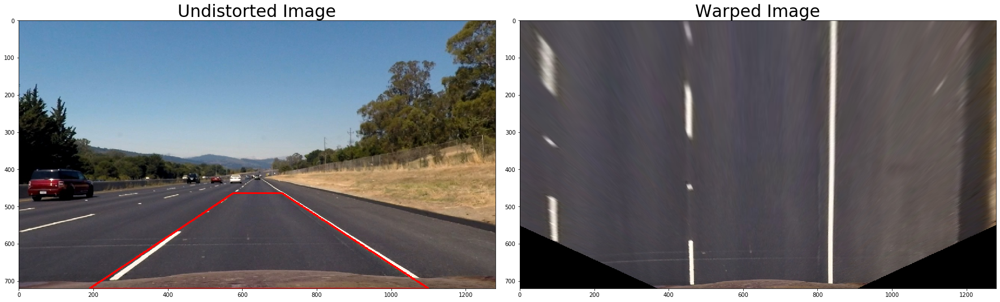

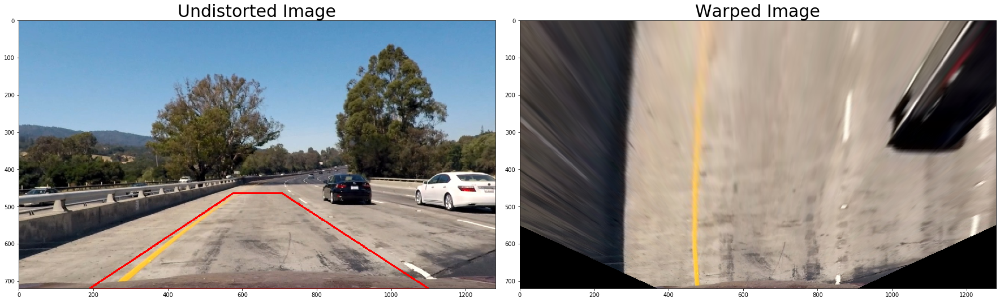

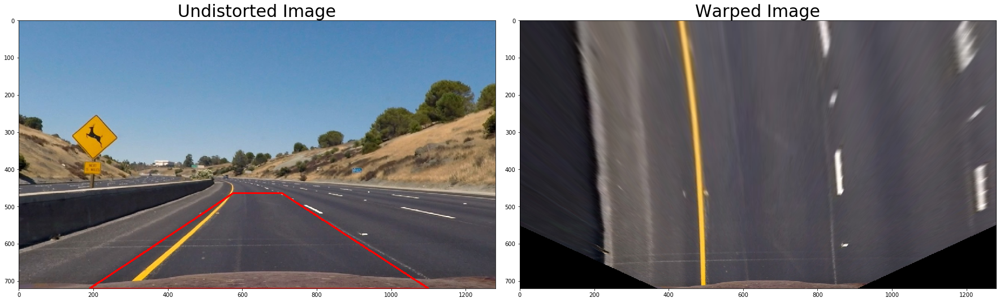

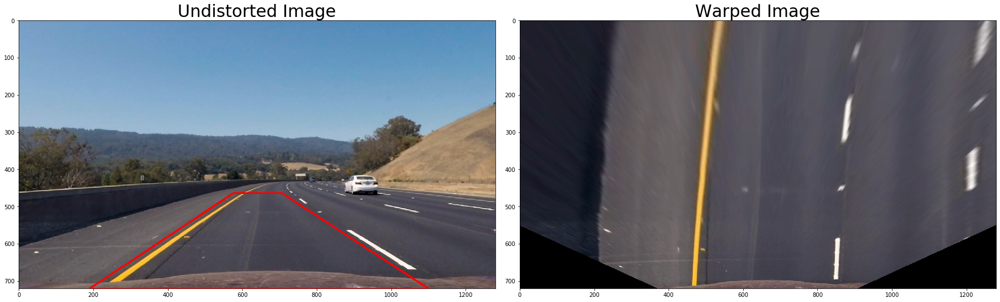

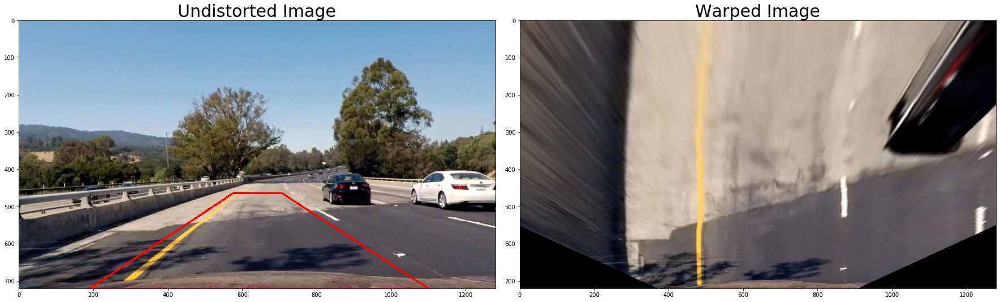

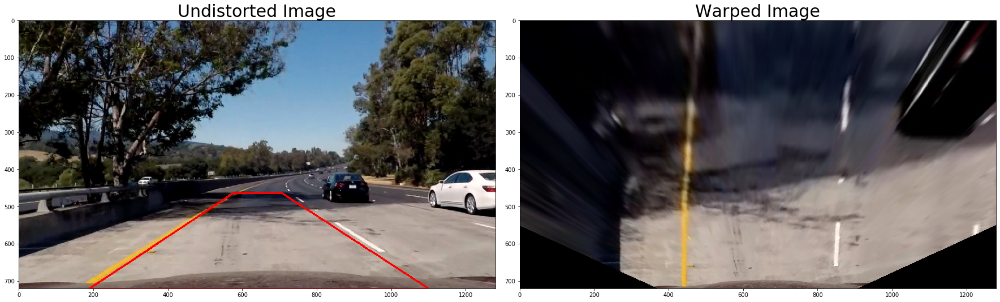

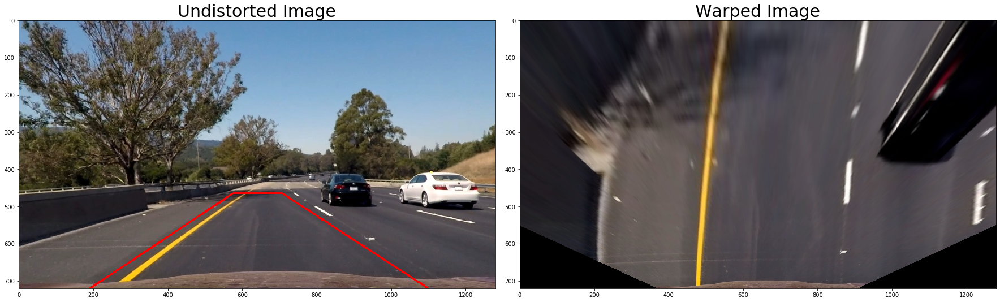

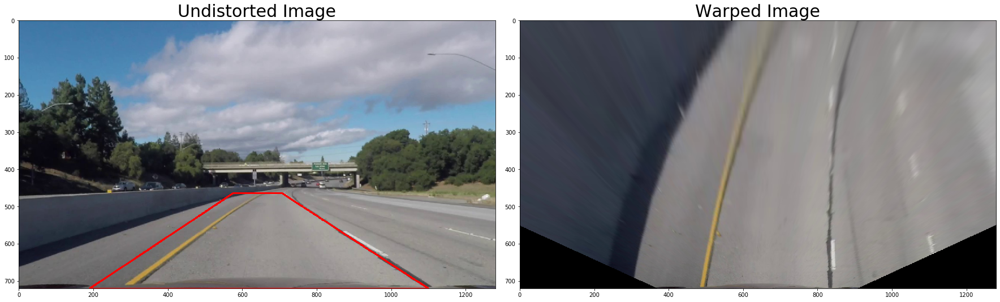

In [10]:
for test_image in test_image_paths:
    test_image = mpimg.imread(test_image)
    dst = distortion_correction(test_image, calib_data, False)
    #dst = histogram_equalization(dst, False)
    warped, Minv= perspectiveTransform(dst, True)

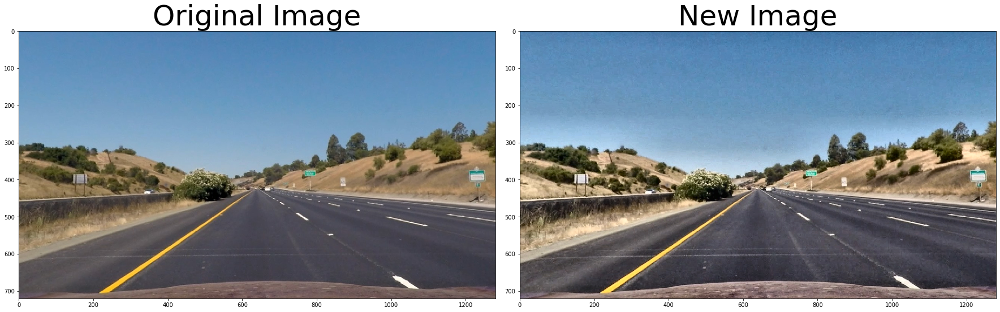

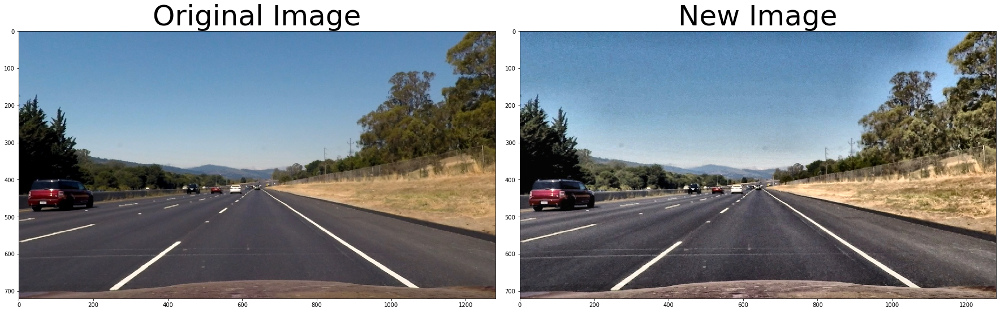

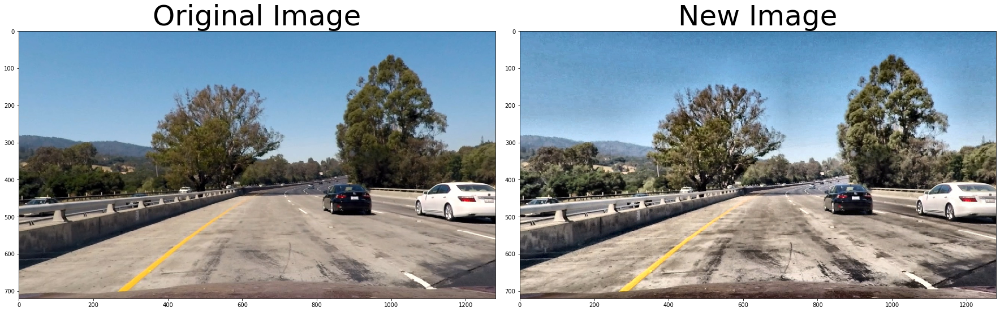

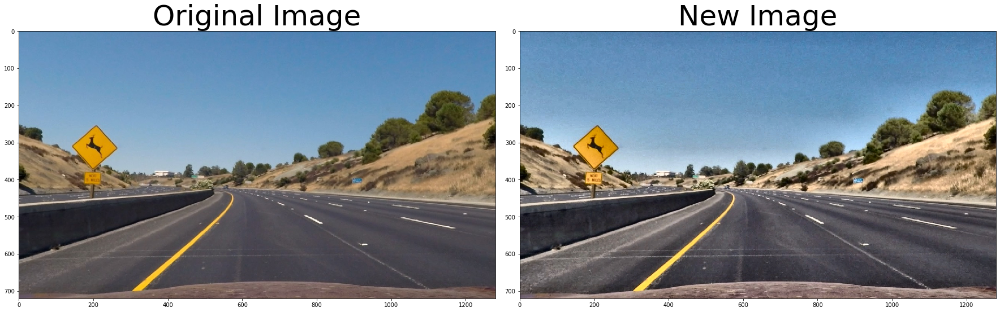

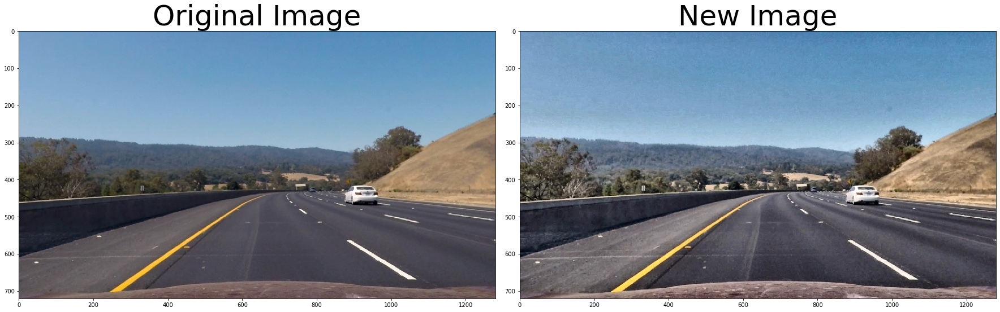

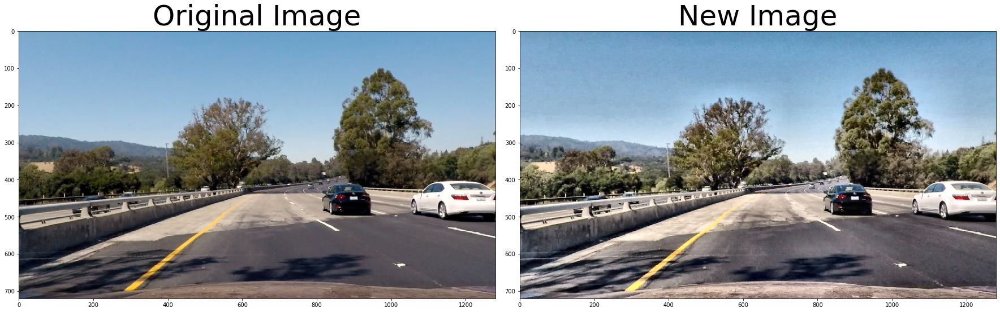

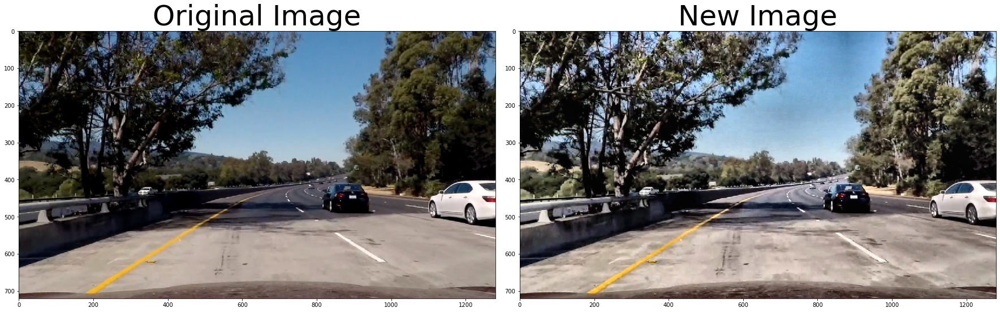

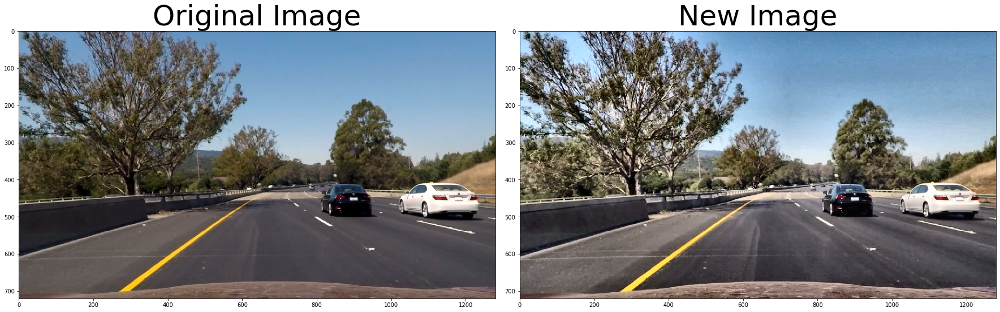

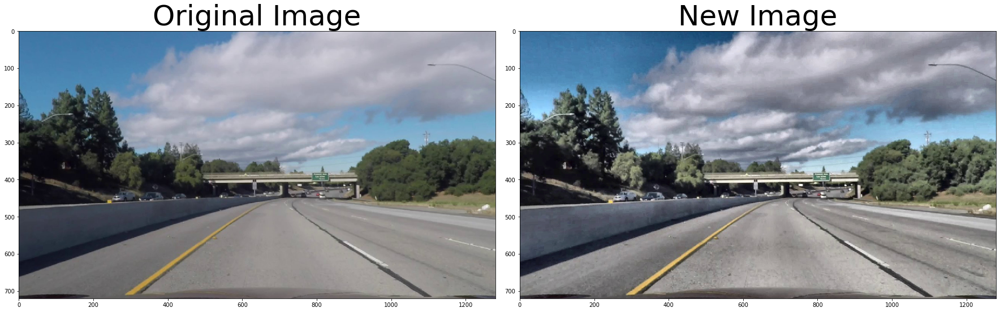

In [11]:
for test_image in test_image_paths:
    test_image = mpimg.imread(test_image)
    dst = distortion_correction(test_image, calib_data, False)
    histogram_equalization(dst, True)

# Converting to different color spaces and Applying Gradient Threshold

In [12]:
def thresh(img, thresh_min, thresh_max):
    ret = np.zeros_like(img)
    ret[(img >= thresh_min) & (img <= thresh_max)] = 1
    return ret

def gradientThreshold(img, show = True):

    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    b = lab[:,:,2]
    if np.max(b) > 175:
        b = b*(255/np.max(b))
    b_binary = np.zeros((img.shape[0], img.shape[1]))
    b_binary[((b > 190) & (b < 255))] = 1
    
    l = hls[:,:,1]
    l = l*(255/np.max(l))
    l_binary = np.zeros((img.shape[0], img.shape[1]))
    l_binary[((l > 220) & (l < 255))] = 1
    
    combined = np.zeros_like(l_binary)
    combined[(l_binary == 1) | (b_binary == 1)] = 1
    
    if show == True:
        # Plotting thresholded images
        f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(17,13))
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
        ax1.set_title('Original Img', fontsize=16)
        ax1.imshow(img)

        ax2.set_title('LAB threshold', fontsize=16)
        ax2.imshow(b_binary, cmap='gray')
        
        ax3.set_title('HLS threshold', fontsize=16)
        ax3.imshow(l_binary, cmap = 'gray')

        ax4.set_title('Combined threshold', fontsize=16)
        ax4.imshow(combined, cmap='gray')

    return combined

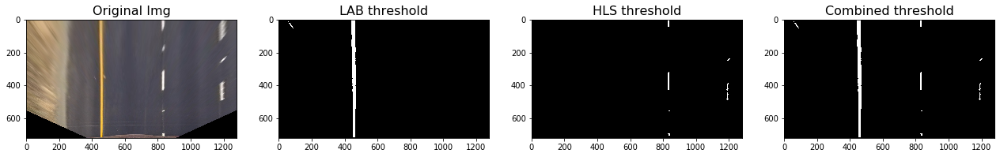

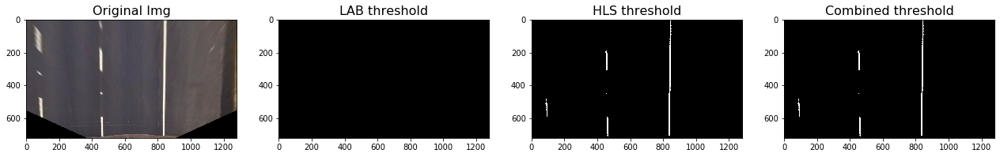

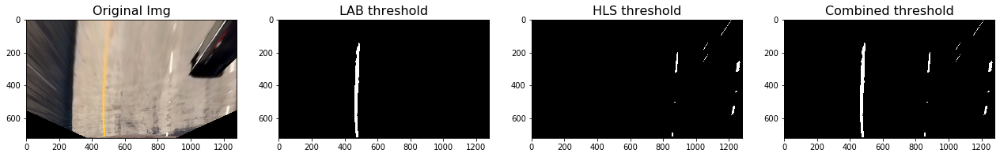

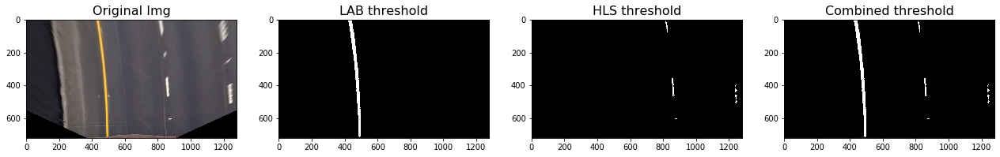

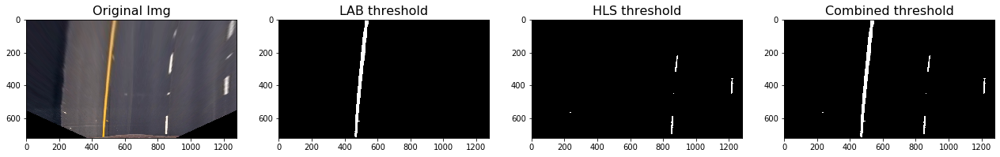

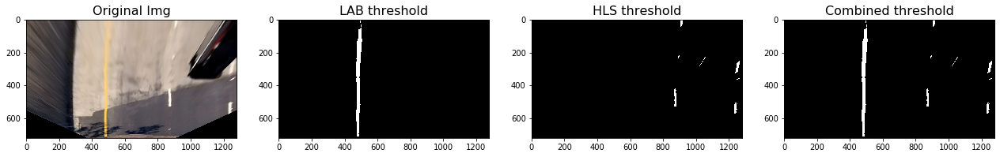

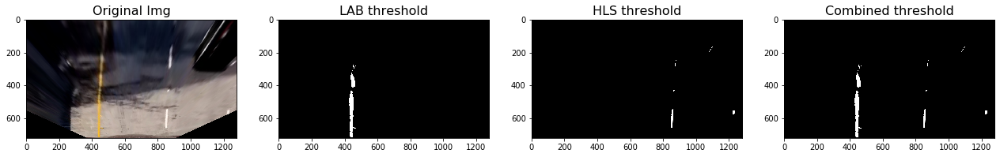

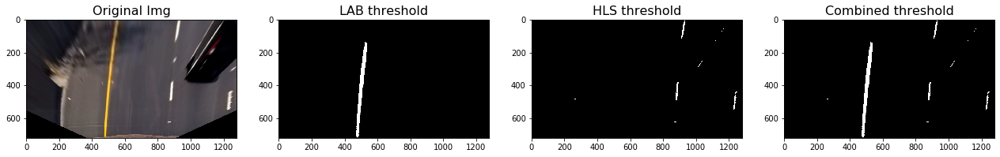

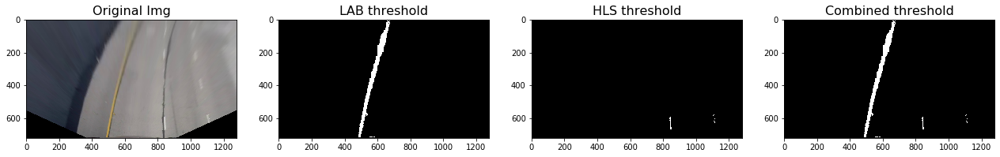

In [13]:
for i,test_image in enumerate(test_image_paths):
    test_image = mpimg.imread(test_image)
    image = distortion_correction(test_image, calib_data, False)
    #image = histogram_equalization(image, False)
    image, Minv = perspectiveTransform(image)
    combined = gradientThreshold(image, True)

In [16]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=21, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    if orient=='x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobel = np.abs(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(gray)
    binary_output[(scaled_sobel>thresh[0])&(scaled_sobel<thresh[1])] = 1
    return binary_output

In [17]:
def sobelGradient(image, show = True, ksize = 21, x_low = 0, x_high = 255, y_low = 0, y_high = 255):
    gradx = abs_sobel_thresh(image, orient = 'x',sobel_kernel=ksize, thresh=(54, 212) )
    grady = abs_sobel_thresh(image, orient = 'y',sobel_kernel=ksize, thresh=(y_low, y_high) )
    combined_binary = np.zeros((image.shape[0], image.shape[1]))
    combined_binary[(gradx == 1) ] = 1
    
    if show == True:
        # Plotting thresholded images
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(17,13))
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
        ax1.set_title('Original Img', fontsize=16)
        ax1.imshow(image)

        ax2.set_title('gradx threshold', fontsize=16)
        ax2.imshow(gradx, cmap='gray')
        
        ax3.set_title('Combined threshold', fontsize=16)
        ax3.imshow(combined_binary, cmap='gray')

    return combined_binary

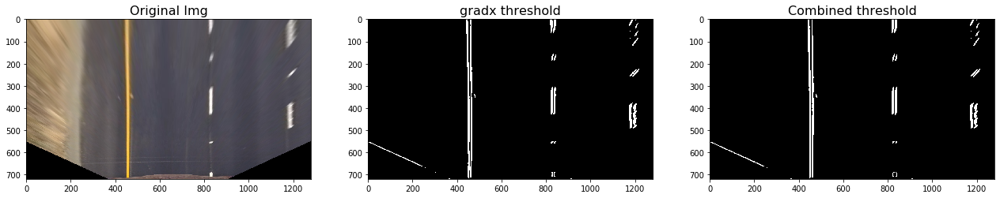

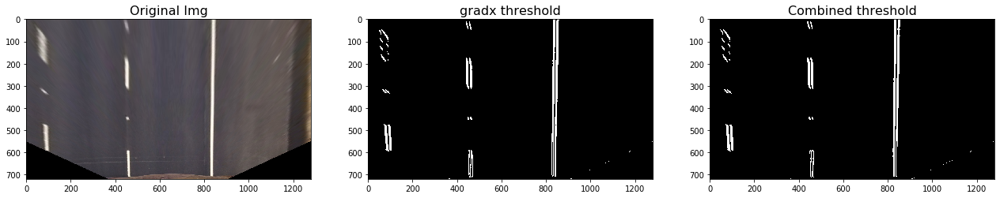

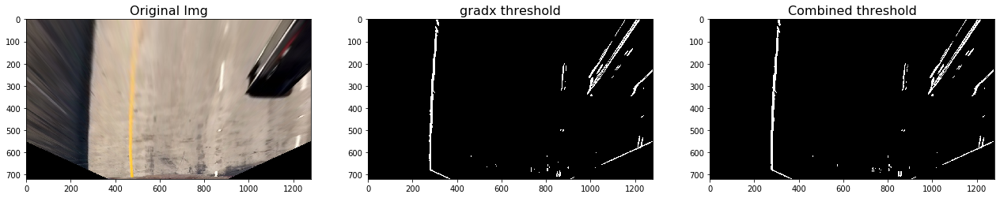

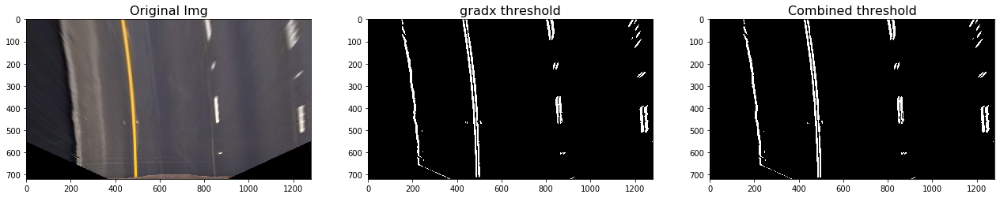

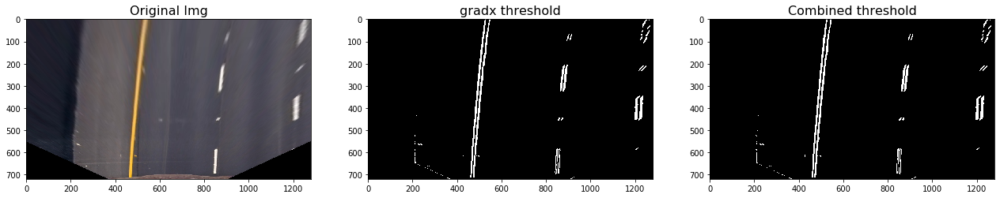

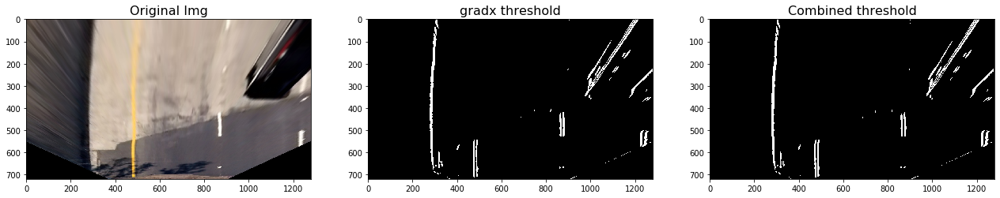

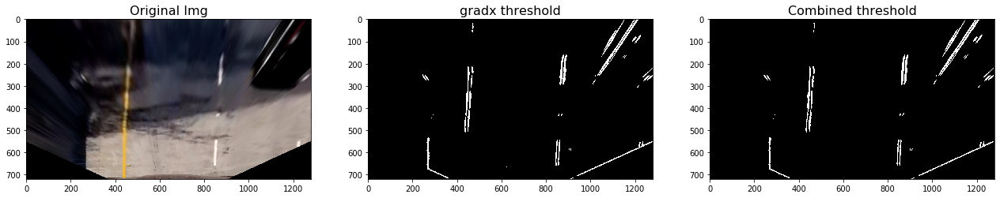

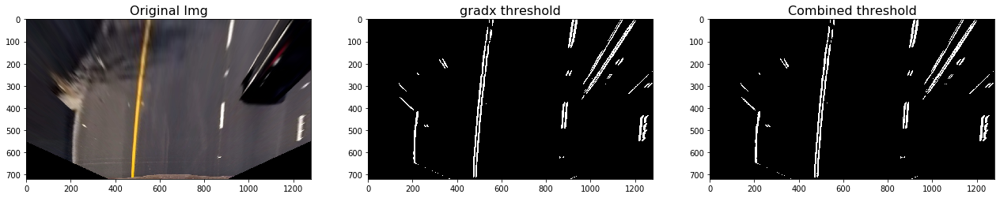

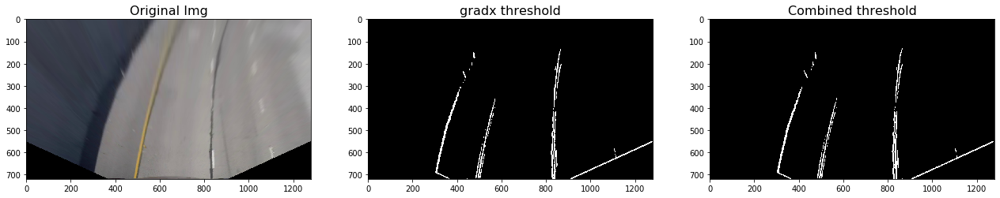

In [18]:
for i,test_image in enumerate(test_image_paths):
    test_image = mpimg.imread(test_image)
    image = distortion_correction(test_image, calib_data, False)
    #image = histogram_equalization(image, False)
    image, Minv = perspectiveTransform(image)
    combined =sobelGradient(image, show = True)

In [19]:
def Threshold(image, return_all = False):
    sobel_combined =sobelGradient(image, show = False)
    color_combined = gradientThreshold(image, show = False)
    combined = np.zeros_like(color_combined)
    combined[((color_combined == 1) | (sobel_combined == 1))] =1
    kernel = np.ones((5, 5), np.uint8)
    combined = cv2.morphologyEx(combined.astype(np.uint8), cv2.MORPH_CLOSE, kernel)
    if return_all:
        return sobel_combined, color_combined, combined
    else:
        return combined

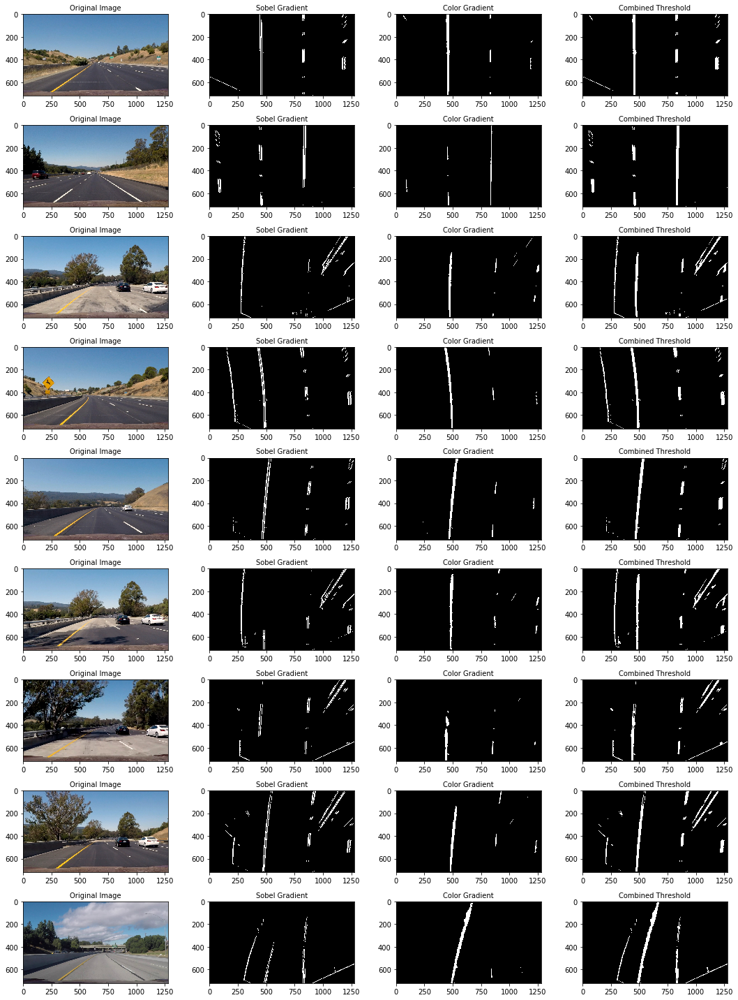

In [20]:
f, ax = plt.subplots(9, 4 , figsize = (15,20))
for i,test_image in enumerate(test_image_paths):
    test_image = mpimg.imread(test_image)
    image = distortion_correction(test_image, calib_data, False)
    #image = histogram_equalization(image, False)
    image, Minv = perspectiveTransform(image)
    sobel_combined, color_combined, combined = Threshold(image, True)
    f.tight_layout()
    ax[i][0].set_title('Original Image', fontsize = 10)
    ax[i][0].imshow(test_image)
    ax[i][1].set_title('Sobel Gradient', fontsize = 10)
    ax[i][1].imshow(sobel_combined, cmap = 'gray')
    ax[i][2].set_title('Color Gradient' , fontsize = 10)
    ax[i][2].imshow(color_combined, cmap = 'gray')
    ax[i][3].set_title('Combined Threshold', fontsize =10)
    ax[i][3].imshow(combined, cmap = 'gray')

# Displaying Histogram

In [21]:
def displayHistogram(binary_image):
    histogram = np.sum(binary_image[binary_image.shape[0]//2:,:], axis=0)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    ax1.set_title('Threshold Image', fontsize=16)
    ax1.imshow(binary_image, cmap = 'gray')
    
    ax2.set_title('Histogram', fontsize=16)
    ax2.plot(histogram)

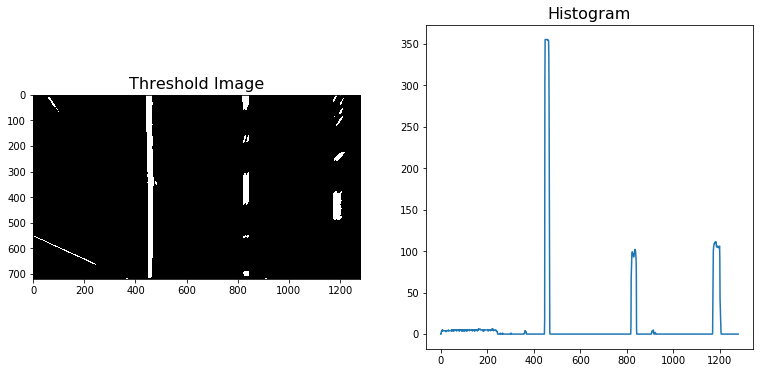

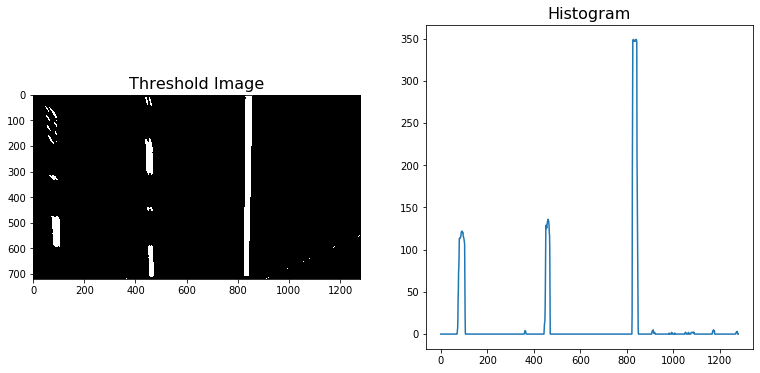

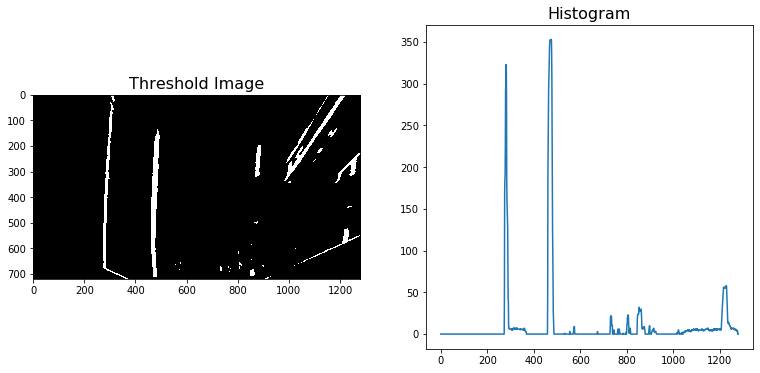

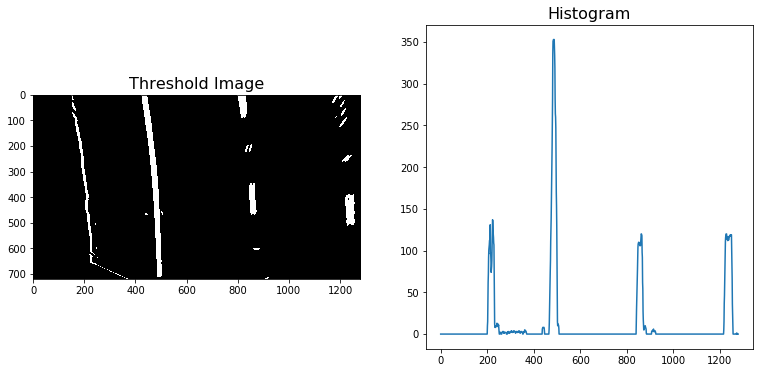

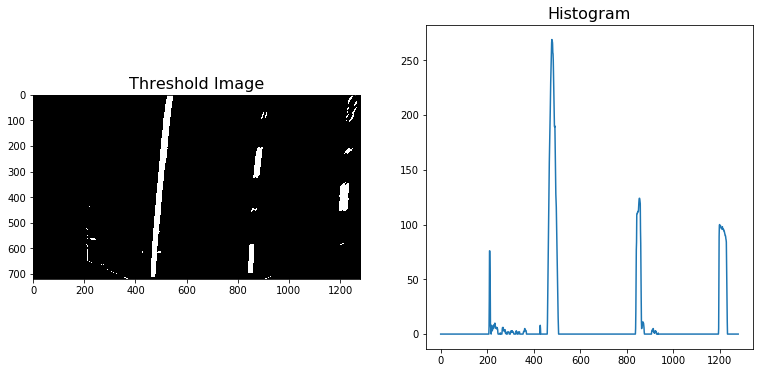

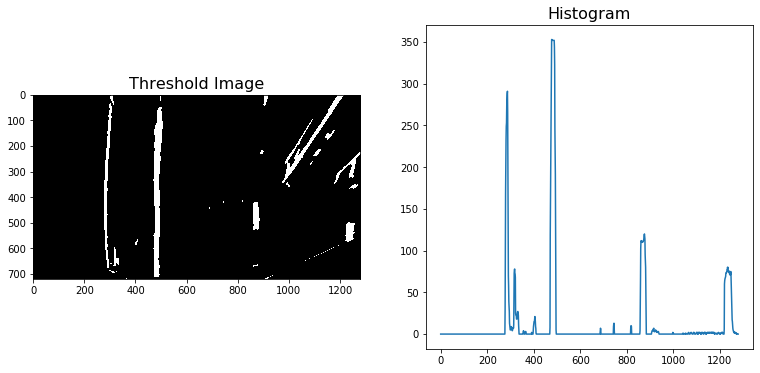

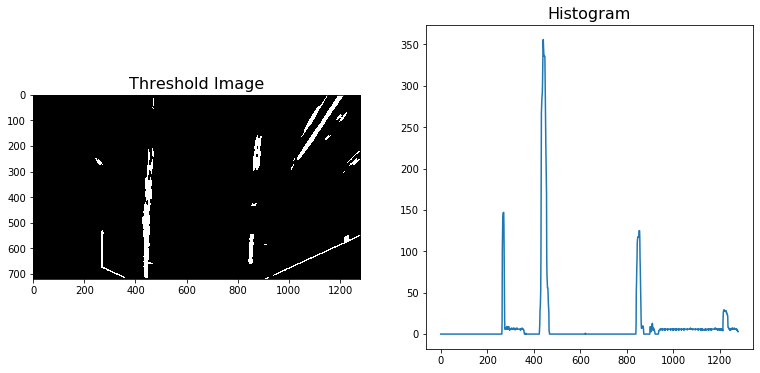

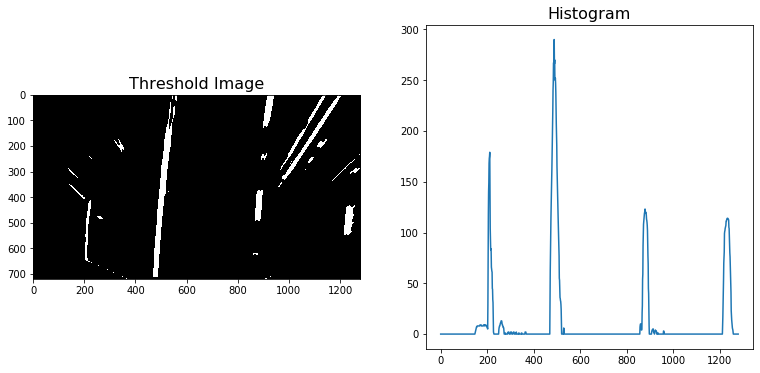

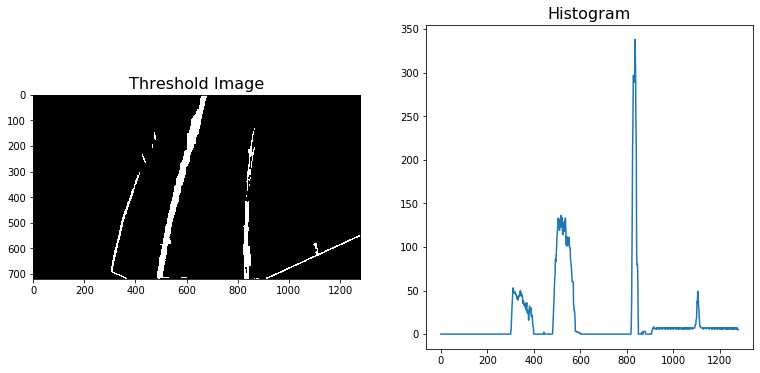

In [22]:
for test_image in test_image_paths:
    test_image = mpimg.imread(test_image)
    image = distortion_correction(test_image, calib_data, False)
    #image = histogram_equalization(image, False)
    image, Minv = perspectiveTransform(image)
    combined_binary= Threshold(image)
    displayHistogram(combined_binary)

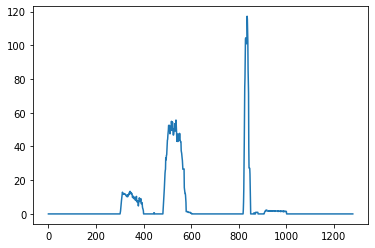

In [23]:
test_image = mpimg.imread(test_image_paths[8])
image = distortion_correction(test_image, calib_data, False)
#image = histogram_equalization(image, False)
image, Minv = perspectiveTransform(image)
combined_binary = Threshold(image)
histogram = np.sum(combined_binary[combined_binary.shape[0]//2:,:], axis=0)

x = np.array(range(0,1280//2))
x = np.append(x,x[::-1])
for i in range(x.size):
    if (i < 250 or i > 1000):
        x[i] = 0
x=x/x.size
histogram_updated = histogram * x
plt.plot(histogram_updated)
#plt.plot(histogram)

# Clipping Binary Data for clean Histogram

In [24]:
def clipBinaryImage(binary_image):
    for j in range(binary_image.shape[0]):
        for i in range(binary_image.shape[1]):
            if ( i <400 or i > 1000):
                binary_image[j][i] = 0
    return binary_image

# Multiplying the Histogram with Weights 

In [25]:
#clipping the side histogram 
def displayHistogram_clip(binary_image, display = False):
    
    binary_image = clipBinaryImage(binary_image)
    histogram = np.sum(binary_image[binary_image.shape[0]//2:,:], axis=0)
    x = np.array(range(0,1280//2))
    x = np.append(x,x[::-1])
    #for i in range(x.size):
    #    if (i < 250 or i > 1000):
    #        x[i] = 0
    x=x/x.size
    histogram_updated = histogram * x
    midpoint = np.int(histogram_updated.shape[0]//2)
    leftx_base = np.argmax(histogram_updated[:midpoint])
    rightx_base = np.argmax(histogram_updated[midpoint:]) + midpoint
    text = 'left base :{} right base :{}  difference: {} '.format(leftx_base, rightx_base, rightx_base - leftx_base)
    if display :
        f, (ax1, ax2 , ax3) = plt.subplots(1, 3, figsize=(10,3))
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        ax1.set_title('Threshold Image', fontsize=10)
        ax1.imshow(binary_image, cmap = 'gray')
        ax2.set_title('Histogram', fontsize=10)
        ax2.plot(histogram)
        ax3.set_title(text, fontsize=10)
        ax3.plot(histogram_updated)
    else:
        return histogram_updated.reshape(-1,1)

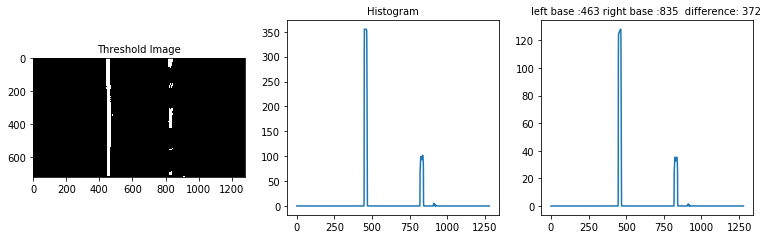

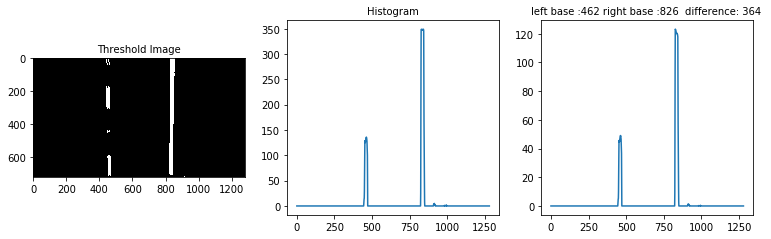

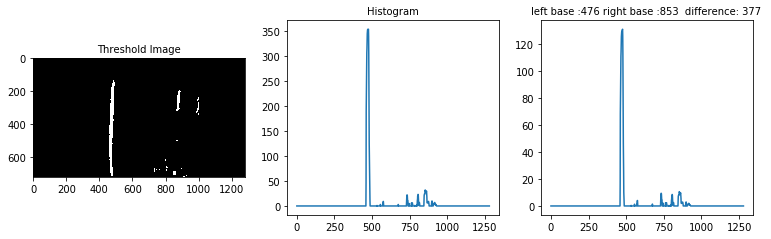

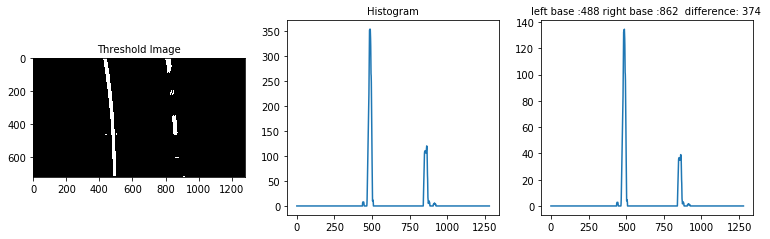

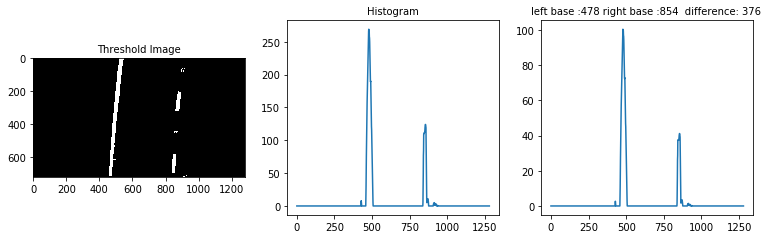

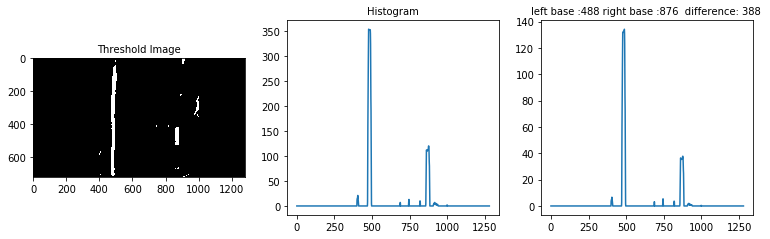

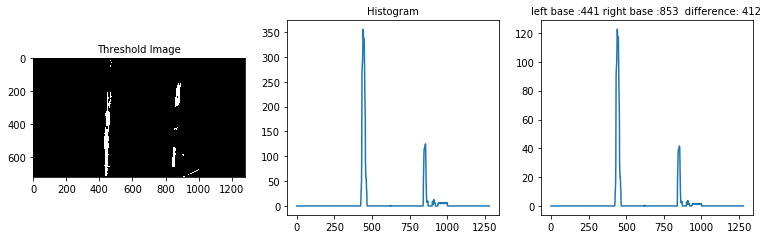

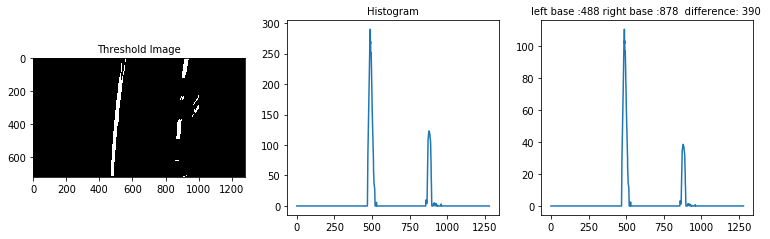

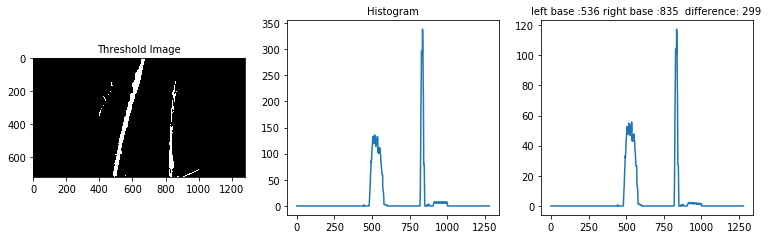

In [26]:
for test_image in test_image_paths:
    test_image = mpimg.imread(test_image)
    image = distortion_correction(test_image, calib_data, False)
    #image = histogram_equalization(image, False)
    image, Minv = perspectiveTransform(image)
    combined_binary = Threshold(image)
    displayHistogram_clip(combined_binary, True)


# Finding Lane Line Demo

In [27]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = displayHistogram_clip(binary_warped)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    print(binary_warped.shape)
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 50
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 

        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low)  & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low)  & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        #pass # Remove this when you add your function
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        #pass
        print('Exception Raised :', ValueError)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    leftx = leftx[np.argsort(lefty)]
    lefty = lefty[np.argsort(lefty)]
    rightx = rightx[np.argsort(righty)]
    righty = righty[np.argsort(righty)]
    
    leftx = np.append(leftx, leftx_base)
    lefty = np.append(lefty, 719)
    rightx = np.append(rightx, rightx_base)
    righty = np.append(righty, 719)
    
    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img



(720, 1280)


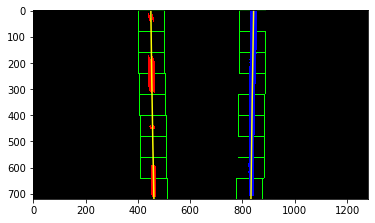

In [28]:
test_image = mpimg.imread(test_image_paths[1])
image = distortion_correction(test_image, calib_data, False)
#image = histogram_equalization(image, False)
image, Minv = perspectiveTransform(image)
combined_binary = Threshold(image)
#displayHistogram_clip(combined_binary)
combined_binary = clipBinaryImage(combined_binary)
out_img  = fit_polynomial(combined_binary)
plt.imshow(out_img)

# Drawing the lane line back on original Image

In [31]:
def sliding_window_demo(binary_warped, draw_Windows = False):
    
    # Take a histogram of the bottom half of the image
    histogram = displayHistogram_clip(binary_warped, False)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    # Find the peak of the left and right halves of the histogram
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    #plt.plot(histogram)
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 50
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
   
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin  
        win_xright_low = rightx_current - margin 
        win_xright_high = rightx_current + margin  
        
        if draw_Windows:
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),
            (win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),
            (win_xright_high,win_y_high),(0,255,0), 2) 
            
        ###Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low)  & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low)  & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        #pass
        print('Exception Raised :', ValueError)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    #######################################################################################

    return leftx, lefty, rightx, righty

In [32]:
left_fit, right_fit , ploty = np.array([]), np.array([]), np.array([])

In [36]:
def reset_data():
    global left_fit, right_fit , ploty
    left_fit, right_fit , ploty = np.array([]), np.array([]), np.array([])
    

In [37]:
def fit_polynomial(img_shape, leftx, lefty, rightx, righty):
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
    return left_fit, right_fit, left_fitx, right_fitx, ploty

In [47]:
def search_lane_demo(binary_warped, ym_per_pix = 30/720, xm_per_pix = 3.7/700):
    
    global left_fit, right_fit
    img_shape = binary_warped.shape
    if (len(left_fit) == 0) & (len(right_fit) == 0):
        leftx, lefty, rightx, righty = sliding_window_demo(binary_warped, True)
        
    else:
        margin = 50
        
        # Grab activated pixels
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])

        left_fitx = left_fit[0] * nonzeroy ** 2 + left_fit[1] * nonzeroy + left_fit[2]
        right_fitx = right_fit[0] * nonzeroy ** 2 + right_fit[1] * nonzeroy +  right_fit[2]
        left_lane_inds = (( nonzerox >=left_fitx - margin) &(nonzerox < left_fitx + margin)).nonzero()[0]
        right_lane_inds = (( nonzerox >=right_fitx - margin) &(nonzerox < right_fitx + margin)).nonzero()[0]


        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
    

    # Fit new polynomials
    left_fit, right_fit, left_fitx, right_fitx, ploty = fit_polynomial(img_shape, leftx, lefty, rightx, righty)
    
    #Find Radius of curvature
    curvature = measure_curvature_pixels(img_shape, leftx, lefty, rightx, righty, left_fit, right_fit)
    #defining window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    window_img = np.zeros_like(out_img)
    left_line= np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_line = np.array([np.flipud(np.transpose(np.vstack([right_fitx, 
                              ploty])))])
    activated_line = np.hstack((left_line, right_line))
    
    #result = plot(window_img, out_img, activated_line, left_fitx, right_fitx, ploty)
    #return result
    return window_img, out_img, activated_line, left_fitx, right_fitx, ploty, curvature



In [44]:
def measure_curvature_pixels(image_size, leftx, lefty, rightx, righty, left_fit, right_fit):

    left_c = left_fit[0] * image_size[0] ** 2 + left_fit[1] * image_size[0] + left_fit[2]
    right_c = right_fit[0] * image_size[0] ** 2 + right_fit[1] * image_size[0] + right_fit[2]
    width = right_c - left_c
    xm_per_pix = 3.7 / width
    ym_per_pix = 30/720
    
    leftx = leftx[::-1]
    rightx = rightx[::-1]
    leftx = leftx * xm_per_pix
    rightx = rightx * xm_per_pix
    lefty = lefty * ym_per_pix
    righty = righty * ym_per_pix
        
    y_eval = np.max(lefty)
        
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
        
    left_curvature = ((1 + (2* left_fit[0] * y_eval + left_fit[1])**2)**1.5) / (np.abs(2*left_fit[0]))
    right_curvature = ((1 + (2* right_fit[0] * y_eval + right_fit[1])**2)**1.5) / (np.abs(2*right_fit[0]))
        
    
    return np.int((left_curvature+right_curvature)/2)

In [45]:
def plot_image_demo(window_img, out_img, activated_line):
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([activated_line]), (0,255, 0))
    #result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    #plt.imshow((result* 255).astype(np.uint8))
    window_img = np.asarray(window_img, np.uint8)
    return window_img

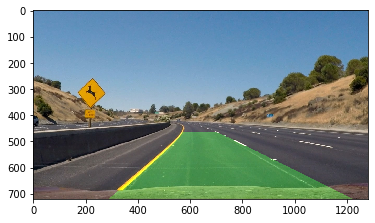

In [48]:
test_image = mpimg.imread(test_image_paths[3])
image = distortion_correction(test_image, calib_data, False)
#image = histogram_equalization(image, False)
image, Minv = perspectiveTransform(image)
combined_binary = Threshold(image)
#displayHistogram_clip(combined_binary)
combined_binary = clipBinaryImage(combined_binary)
img_size = combined_binary.shape
reset_data()
window_img, out_img, activated_line, left_fitx, right_fitx, ploty , curvature= search_lane_demo(combined_binary)
window_img = plot_image_demo(window_img, out_img, activated_line)
unwarped = cv2.warpPerspective(window_img, Minv, (img_size[1], img_size[0]) , flags=cv2.INTER_LINEAR)
result = cv2.addWeighted(test_image, 1, unwarped, 0.3, 0)
plt.imshow(result.astype(np.uint8))

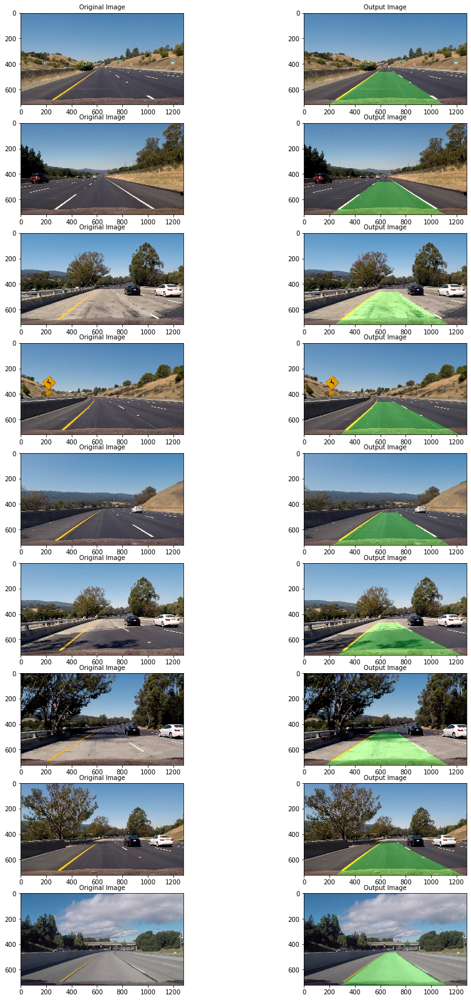

In [49]:
f, ax = plt.subplots(9,2, figsize = (12, 24))
f.tight_layout()
for i,test_image in enumerate(test_image_paths):
    test_image = mpimg.imread(test_image)
    image = distortion_correction(test_image, calib_data, False)
    #image = histogram_equalization(image, False)
    image, Minv = perspectiveTransform(image)
    combined_binary = Threshold(image)
    #displayHistogram_clip(combined_binary)
    combined_binary = clipBinaryImage(combined_binary)
    img_size = combined_binary.shape
    reset_data()
    
    window_img, out_img, activated_line, left_fitx, right_fitx, ploty , curvature= search_lane_demo(combined_binary)
    window_img = plot_image_demo(window_img, out_img, activated_line)
    unwarped = cv2.warpPerspective(window_img, Minv, (img_size[1], img_size[0]) , flags=cv2.INTER_LINEAR)
    result = cv2.addWeighted(test_image, 1, unwarped, 0.3, 0)
    #result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
        
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    ax[i][0].set_title('Original Image', fontsize=10)
    ax[i][0].imshow(test_image)
    ax[i][1].set_title('Output Image', fontsize=10)
    ax[i][1].imshow(result)

# Establishing Line Class and Information Pipeline

In [50]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.n = 10
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = deque() 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        #self.current_fit = deque([np.array([False])])
        self.current_fit = deque()
        #radius of curvature of twwemmhe line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        #self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None 
        self.x_int = deque()
        self.top = deque()

In [51]:
def sliding_window(binary_warped):
    
    # Take a histogram of the bottom half of the image
    histogram = displayHistogram_clip(binary_warped, False)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    img_shape = binary_warped.shape
    # Find the peak of the left and right halves of the histogram
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        
    #plt.plot(histogram)
        # HYPERPARAMETERS
        # Choose the number of sliding windows
    nwindows = 9
        # Set the width of the windows +/- margin
    margin = 50
        # Set minimum number of pixels found to recenter window
    minpix = 50
    
        # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
       
        # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
        
        # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    
        # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
        # Step through the windows one by one
    for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin  
        win_xright_low = rightx_current - margin 
        win_xright_high = rightx_current + margin  
            
    
            ###Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low)  & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low)  & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
            
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    
        # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
            # Avoids an error if the above is not implemented fully
            #pass
        print('Exception Raised :', ValueError)
    
    # Extract left and right line pixel positions
    leftx = np.array(nonzerox[left_lane_inds]).astype(np.float32)
    lefty = np.array(nonzeroy[left_lane_inds]).astype(np.float32) 
    rightx = np.array(nonzerox[right_lane_inds]).astype(np.float32)
    righty = np.array(nonzeroy[right_lane_inds]).astype(np.float32)
    
    #######################################################################################
    if len(leftx) > 0 & len(lefty) >0:
        left.detected = True
    else:
        left.detected = False
    
    if len(rightx) > 0 & len(righty) > 0:
        right.detected = True
    else:
        right.detected = False

    ##############################################################################################################
    
    #left_fit, right_fit, left_fitx, right_fitx, ploty = fit_polynomial_1(img_shape, leftx, lefty, rightx, righty)
        
    #curvature = measure_curvature_pixels_1(leftx, lefty, rightx, righty)
    #return left_fit, right_fit, left_fitx, right_fitx, ploty , curvature

    ########################################################################
    
    return leftx, lefty, rightx, righty

In [52]:
def fit_polynomial(img_shape, leftx, lefty, rightx, righty):
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0] )
    
    #################################################
    left.ally = ploty
    right.ally = ploty
    
    if len(left.current_fit) >=  0 :
        if len(left.current_fit) ==  0:
            left.best_fit = left_fit
            left.current_fit.append(left.best_fit)
        left.diffs = abs(left.current_fit[-1] - left_fit)
        
        if (left.diffs[0] > 0.001) or (left.diffs[1] > 1.0) or (left.diffs[2] > 100.0):
                left.detected = False
                left_fit = left.current_fit[-1]
                left.best_fit = left_fit
        else:
            if len(left.current_fit) >= left.n:
                left.current_fit.popleft()
            
            left.best_fit = (np.mean(left.current_fit, axis = 0) * 0.95 + 0.05 * left_fit).reshape(3,)
            left.current_fit.append(left_fit)
        
    if len(right.current_fit) >= 0:
        if len(right.current_fit) == 0:
            right.best_fit = right_fit
            right.current_fit.append(right.best_fit)
        right.diffs = abs(right.current_fit[-1] - right_fit)
        if (right.diffs[0] > 0.001) or (right.diffs[1] > 1.0) or (right.diffs[2] > 100.0):
                right.detected = False
                right_fit = right.current_fit[-1]
                right.best_fit = right_fit
        else:
            if len(right.current_fit) >= right.n:
                right.current_fit.popleft()
            right.best_fit = (np.mean(right.current_fit, axis = 0)* 0.95 + 0.05 * right_fit).reshape(3,)
            right.current_fit.append(right_fit)

    
    #left.best_fit = np.sum(left.current_fit[:-1], axis = 0) * 0.95 + 0.05 * left_fit
    #right.best_fit = np.sum(right.current_fit[:-1], axis = 0)* 0.95 + 0.05 * right_fit
    
    ############################################################################
    
    #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    #try:
    #    left_fitx = left.best_fit[0]*ploty**2 + left.best_fit[1]*ploty + left.best_fit[2]
    #    right_fitx = right.best_fit[0]*ploty**2 + right.best_fit[1]*ploty + right.best_fit[2]
    #except TypeError:
            # Avoids an error if `left` and `right_fit` are still none or incorrect
    #    print('The function failed to fit a line!')
    #    left_fitx = 1*lefty**2 + 1*ploty
    #    right_fitx = 1*righty**2 + 1*ploty
    
    left_fitx = left.best_fit[0]*left.ally**2 + left.best_fit[1]*left.ally + left.best_fit[2]
    right_fitx = right.best_fit[0]*right.ally**2 + right.best_fit[1]*right.ally + right.best_fit[2]
    
    curvature = measure_curvature_pixels(img_shape, leftx, lefty, rightx, righty, left.best_fit, right.best_fit)
    return left_fit, right_fit, left_fitx, right_fitx, curvature
    

In [53]:
def search_lane(binary_warped, left_fit, right_fit):
        
    margin = 50
    img_size = binary_warped.shape    
        # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_fit = left_fit.reshape(3,)
    right_fit = right_fit.reshape(3,)
    
    left_fitx = left_fit[0] * nonzeroy ** 2 + left_fit[1] * nonzeroy + left_fit[2]
    right_fitx = right_fit[0] * nonzeroy ** 2 + right_fit[1] * nonzeroy +  right_fit[2]
    left_lane_inds = (( nonzerox >=left_fitx - margin) &(nonzerox < left_fitx + margin)).nonzero()[0]
    right_lane_inds = (( nonzerox >=right_fitx - margin) &(nonzerox < right_fitx + margin)).nonzero()[0]
    
    
    # Extract left and right line pixel positions
    leftx = np.array(nonzerox[left_lane_inds]).astype(np.float32)
    lefty = np.array(nonzeroy[left_lane_inds]).astype(np.float32) 
    rightx = np.array(nonzerox[right_lane_inds]).astype(np.float32)
    righty = np.array(nonzeroy[right_lane_inds]).astype(np.float32)
    
    
    if len(leftx) > 0 & len(lefty) >0:
        left.detected = True
    if len(rightx) > 0 & len(righty) > 0:
        right.detected = True
    else:
        left.detected = False
        right.detected = False
        
    #######################################################################################################
    
        # Fit new polynomials
    #left_fit, right_fit, left_fitx, right_fitx, ploty = fit_polynomial_1(img_size, leftx, lefty, rightx, righty)
    #curvature = measure_curvature_pixels_1(leftx, lefty, rightx, righty)
    #return left_fit, right_fit, left_fitx, right_fitx, ploty , curvature   
    

    ############################################################################################################
    return leftx, lefty, rightx, righty

In [54]:
def measure_curvature_pixels(image_size, leftx, lefty, rightx, righty, left_fit, right_fit):

    left_c = left_fit[0] * image_size[0] ** 2 + left_fit[1] * image_size[0] + left_fit[2]
    right_c = right_fit[0] * image_size[0] ** 2 + right_fit[1] * image_size[0] + right_fit[2]
    width = right_c - left_c
    xm_per_pix = 3.7 / width
    ym_per_pix = 30/720
    
    leftx = leftx[::-1]
    rightx = rightx[::-1]
    leftx = leftx * xm_per_pix
    rightx = rightx * xm_per_pix
    lefty = lefty * ym_per_pix
    righty = righty * ym_per_pix
        
    y_eval = np.max(lefty)
        
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
        
    left_curvature = ((1 + (2* left_fit[0] * y_eval + left_fit[1])**2)**1.5) / (np.abs(2*left_fit[0]))
    right_curvature = ((1 + (2* right_fit[0] * y_eval + right_fit[1])**2)**1.5) / (np.abs(2*right_fit[0]))
        
    return left_curvature, right_curvature

In [55]:
def lane_center_calculation(left_fitx, right_fitx):
    
    lane_center = (left_fitx[-1] + right_fitx[-1])//2
    
    distance_from_center = abs((640 - lane_center)*3.7/700)
    
    return lane_center , distance_from_center

In [56]:
def plot(out_img, activated_line):
        # Draw the lane onto the warped blank image
    cv2.fillPoly(out_img, np.int_([activated_line]), (0,255, 0))
        #result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        
        # Plot the polynomial lines onto the image
        #plt.plot(left_fitx, ploty, color='yellow')
        #plt.plot(right_fitx, ploty, color='yellow')
        #plt.imshow((result* 255).astype(np.uint8))
    out_img = np.asarray(out_img, np.uint8)
    return out_img   

In [65]:
def pipeline(image):
    
    dst = distortion_correction(image, calib_data, False)
    image = histogram_equalization(dst, False)
    image, Minv = perspectiveTransform(dst)
    combined_binary = Threshold(image)
    #displayHistogram_clip(combined_binary)
    combined_binary = clipBinaryImage(combined_binary)
    
    if (left.detected == True or right.detected == True):
        leftx, lefty, rightx, righty = search_lane(combined_binary, left.current_fit[-1], right.current_fit[-1])
        if (left.detected == False or right.detected == False):
            leftx, lefty, rightx, righty = sliding_window(combined_binary)
        
    
    else:
        leftx, lefty, rightx, righty = sliding_window(combined_binary)
        
    left_fit, right_fit, left_fitx, right_fitx, curvature = fit_polynomial(img_size, leftx, lefty, rightx, righty )
    
    left.radius_of_curvature , right.radius_of_curvature = curvature
        
    lane_center , distance_from_center = lane_center_calculation(left_fitx, right_fitx)
    window_img = np.zeros_like(combined_binary).astype(np.uint8)
    out_img = np.dstack((window_img, window_img, window_img))
    left_line= np.array([np.transpose(np.vstack([left_fitx, left.ally]))])
    right_line = np.array([np.flipud(np.transpose(np.vstack([right_fitx, 
                                  right.ally])))])
    activated_line = np.hstack((left_line, right_line))
    
    #out_img = plot_2_1(out_img, activated_line)
    cv2.fillPoly(out_img, np.int_([activated_line]), (34,255,34))
    cv2.polylines(out_img, np.int_([activated_line]), isClosed=False, color=(0,0,255), thickness = 10)
    
    unwarped = cv2.warpPerspective(out_img, Minv, (img_size[1], img_size[0]) , flags=cv2.INTER_LINEAR)
    result = cv2.addWeighted(dst, 1, unwarped, 0.5, 0)
    
    font                   = cv2.FONT_HERSHEY_SIMPLEX
    positionOfText = (10,80)
    fontScale              = 1
    fontColor              = (255,255,255)
    lineType               = 2
    thickness = 2
    
    cv2.putText(result, 'Center Offset {:.2f}(m)'.format(distance_from_center), positionOfText, 
                font, fontScale,fontColor,thickness ,lineType)
    # Print radius of curvature on video
    cv2.putText(result, 'Radius of Curvature {}(m)'.format(int((left.radius_of_curvature + right.radius_of_curvature)/2)), (10,120),
             font, fontScale,fontColor,thickness ,lineType)
    
    #result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB) 
    return result

# Project Video 1

In [61]:
white_output = 'project_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds

left = Line()
right = Line()
#vertices = createMaskVertices((720,1280), v_top=0.63,v_top_side=.42,v_bottom_side=0.10,v_bottom_offset=0)

#clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

t:   0%|                                                                            | 0/1260 [00:00<?, ?it/s, now=None]

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4
Wall time: 8min 5s


In [63]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))